# 中文CLIP视频搜索演示

In [1]:
!pip install plotly==4.14.3
!pip install opencv-python

Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://pypi.corp.kuaishou.com/kuaishou/prod/+simple/
Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://pypi.corp.kuaishou.com/kuaishou/prod/+simple/


In [2]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '6'
import sys
sys.path.insert(0, '..')
from pathlib import Path
import pandas as pd
import numpy as np
import torch
from clip.clip import build_model
from clip.simple_tokenizer import SimpleCharTokenizer
from clip.data import tokenize, my_transform

In [3]:
import cv2
from PIL import Image

N = 20

# The frame images will be stored in video_frames
video_frames = []

# Open the video file
capture = cv2.VideoCapture('../data/kwai_test.mp4')
fps = capture.get(cv2.CAP_PROP_FPS)

current_frame = 0
while capture.isOpened():
    # Read the current frame
    ret, frame = capture.read()

    # Convert it to a PIL image (required for CLIP) and store it
    if ret == True:
        video_frames.append(Image.fromarray(frame[:, :, ::-1]))
    else:
        break

    # Skip N frames
    current_frame += N
    capture.set(cv2.CAP_PROP_POS_FRAMES, current_frame)

# Print some statistics
print(f"Frames extracted: {len(video_frames)}")

Frames extracted: 216


In [4]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"device: {device}")

device: cuda


In [5]:
state_dict = torch.load('../data/clip_zh.mse.pt')

model = build_model(state_dict).to(device)

embed_dim: 512
vocab_size: 8000
text_projection shape: torch.Size([512, 512])


In [6]:
zh_tokenizer = SimpleCharTokenizer('../data/zh_vocab.txt')

Loading vocab from ../data/zh_vocab.txt


In [7]:
import math
import numpy as np
import torch

# You can try tuning the batch size for very large videos, but it should usually be OK
batch_size = 256
batches = math.ceil(len(video_frames) / batch_size)

# The encoded features will bs stored in video_features
video_features = torch.empty([0, 512], dtype=torch.float16).to(device)

preprocess = my_transform(224)

# Process each batch
for i in range(batches):
    print(f"Processing batch {i+1}/{batches}")

    # Get the relevant frames
    batch_frames = video_frames[i*batch_size : (i+1)*batch_size]
  
    # Preprocess the images for the batch
    batch_preprocessed = torch.stack([preprocess(frame) for frame in batch_frames]).to(device)
  
    # Encode with CLIP and normalize
    with torch.no_grad():
        batch_features = model.encode_image(batch_preprocessed)
        batch_features /= batch_features.norm(dim=-1, keepdim=True)

    # Append the batch to the list containing all features
    video_features = torch.cat((video_features, batch_features))

# Print some stats
print(f"Features: {video_features.shape}")

Processing batch 1/1
Features: torch.Size([216, 512])


In [8]:
import plotly.express as px
import datetime
from IPython.core.display import HTML

def search_video(search_query, display_heatmap=True, display_results_count=3):

    # Encode and normalize the search query using CLIP
    with torch.no_grad():
        text_features = model.encode_text(tokenize(zh_tokenizer, search_query).to(device))
        text_features /= text_features.norm(dim=-1, keepdim=True)

    # Compute the similarity between the search query and each frame using the Cosine similarity
    similarities = (100.0 * video_features @ text_features.T)
    values, best_photo_idx = similarities.topk(display_results_count, dim=0)

    # Display the heatmap
    if display_heatmap:
        print("Search query heatmap over the frames of the video:")
        fig = px.imshow(similarities.T.cpu().numpy(), height=50, aspect='auto', color_continuous_scale='viridis')
        fig.update_layout(coloraxis_showscale=False)
        fig.update_xaxes(showticklabels=False)
        fig.update_yaxes(showticklabels=False)
        fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
        fig.show()
        print()

    # Display the top 3 frames
    
    for frame_id in best_photo_idx:
        seconds = round(frame_id.cpu().numpy()[0] * N / fps)
        print(f"Found at {str(datetime.timedelta(seconds=seconds))}")
        display(video_frames[frame_id])

    # Find the timestamp in the video and display it
    
#     display(HTML(f"Found at {str(datetime.timedelta(seconds=seconds))} (<a target=\"_blank\" href=\"{video_url}&t={seconds}\">link</a>)"))

## 搜索视频内容

Search query heatmap over the frames of the video:



Found at 0:01:44


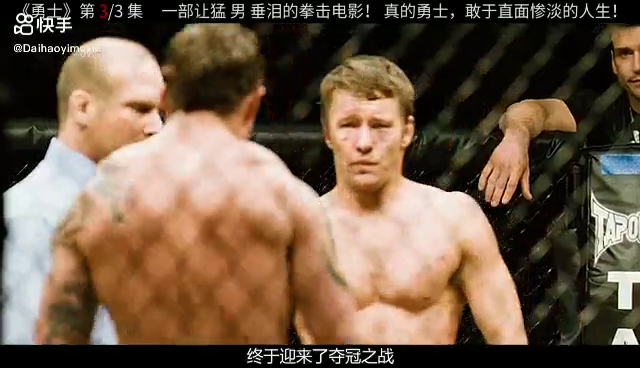

Found at 0:02:21


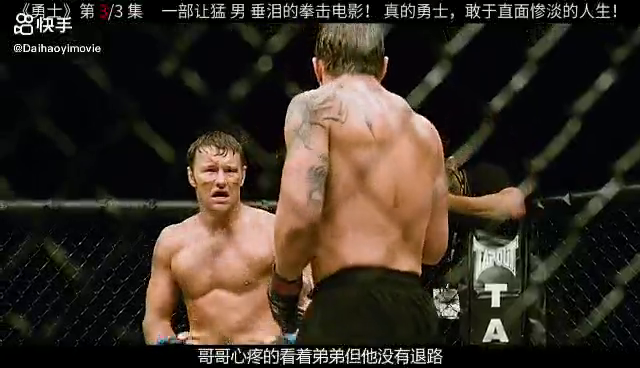

Found at 0:02:52


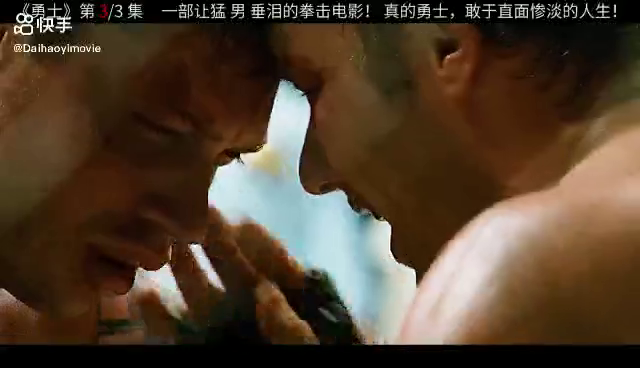

In [9]:
search_video("两个男人决斗")

Search query heatmap over the frames of the video:



Found at 0:01:01


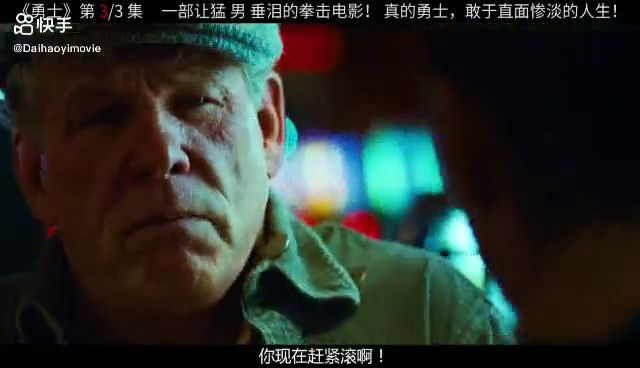

Found at 0:01:05


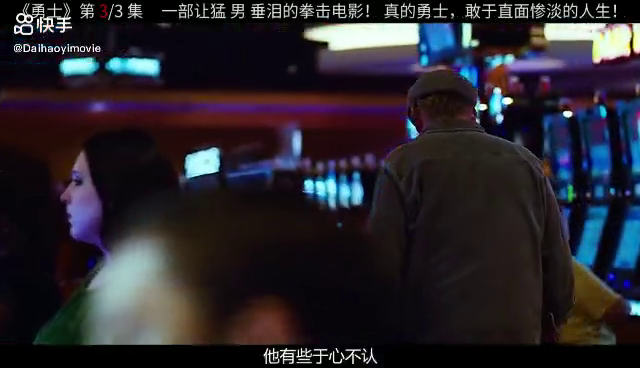

Found at 0:02:18


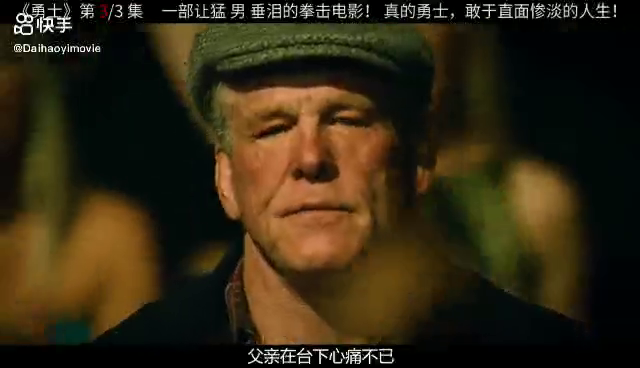

In [10]:
search_video("老父亲")

Search query heatmap over the frames of the video:



Found at 0:01:08


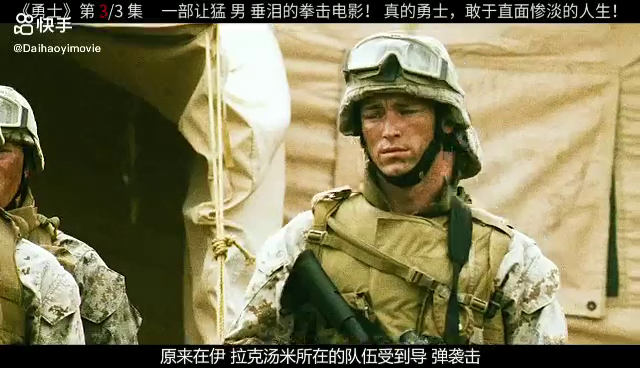

Found at 0:00:44


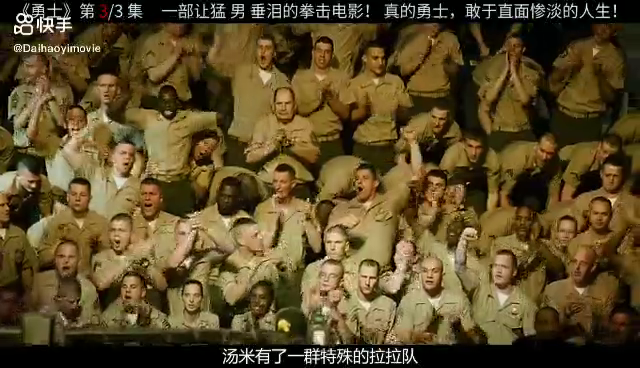

Found at 0:01:25


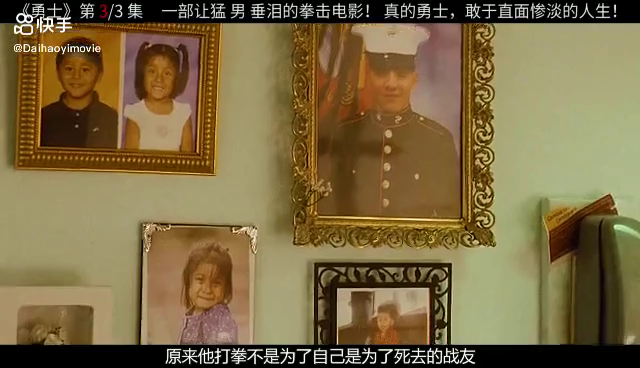

In [11]:
search_video("军人")

Search query heatmap over the frames of the video:



Found at 0:01:07


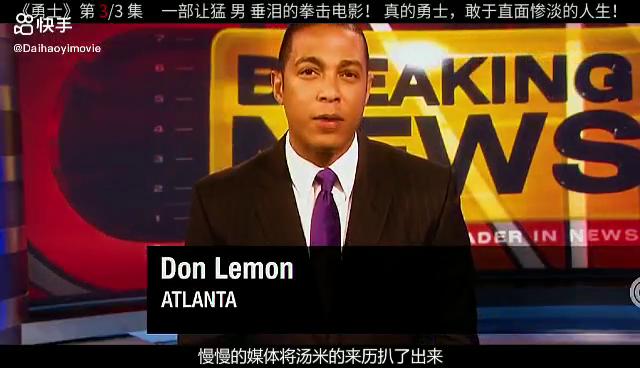

Found at 0:01:06


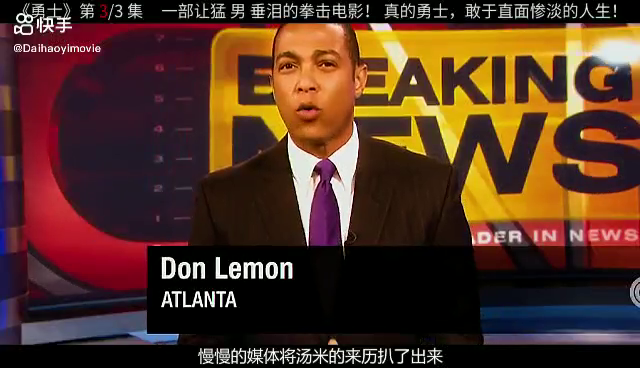

Found at 0:01:14


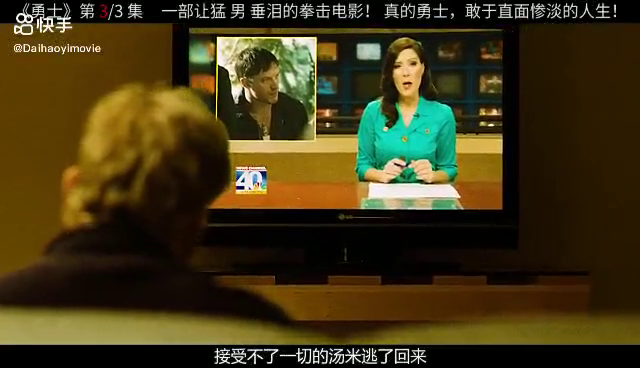

In [12]:
search_video("新闻主播")

Search query heatmap over the frames of the video:



Found at 0:01:38


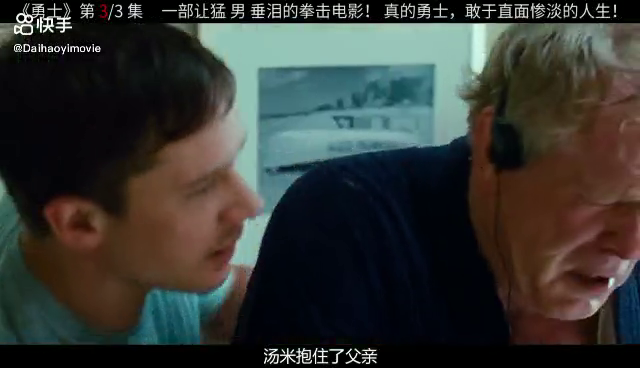

Found at 0:02:52


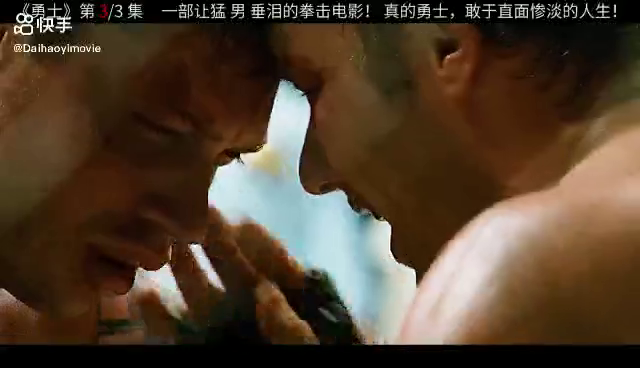

Found at 0:01:39


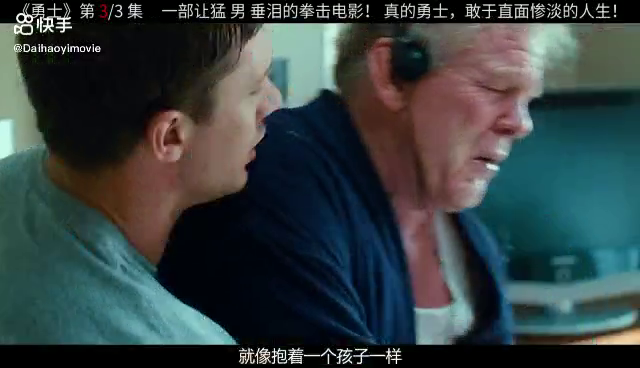

In [13]:
search_video("父子和解")

Search query heatmap over the frames of the video:



Found at 0:02:55


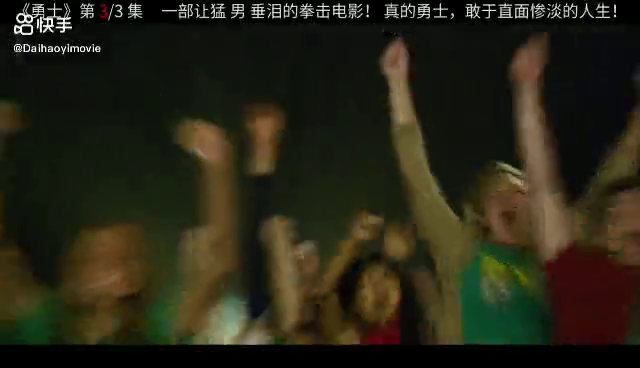

Found at 0:01:52


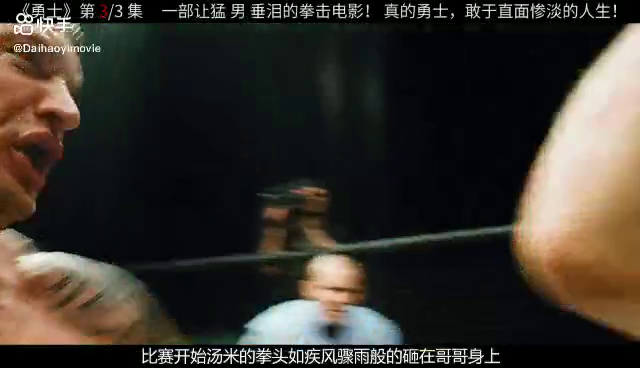

Found at 0:00:46


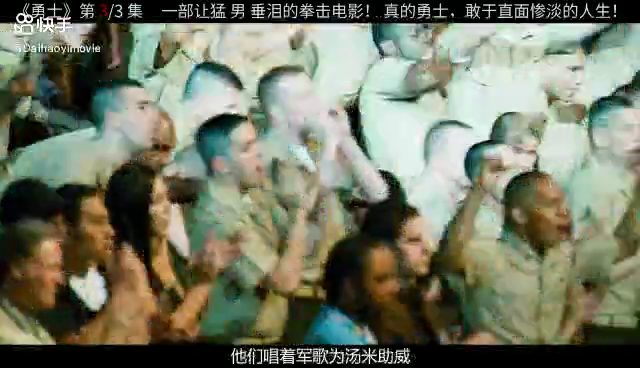

In [14]:
search_video("众人欢呼")

Search query heatmap over the frames of the video:



Found at 0:01:22


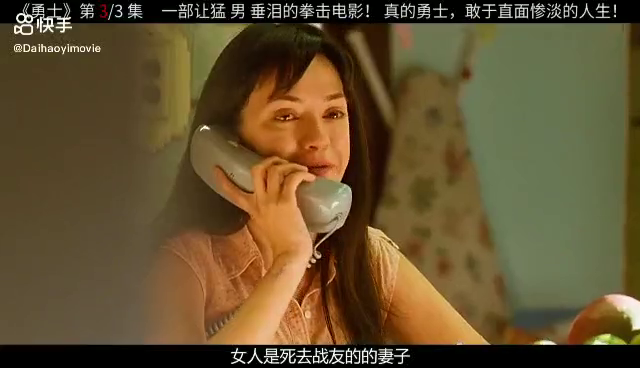

Found at 0:01:23


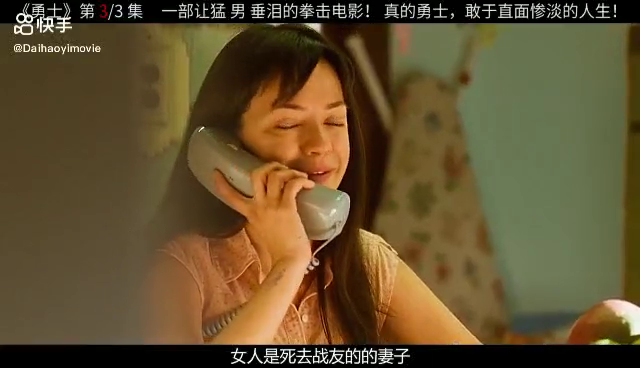

Found at 0:00:19


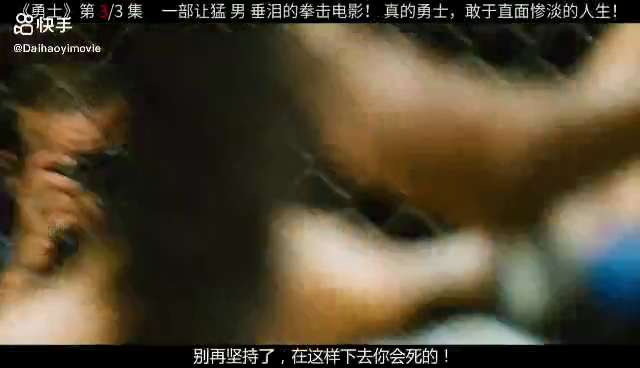

In [15]:
search_video("打电话的女人")

## 观看原视频

In [16]:
import io
import base64
from IPython.display import HTML

video = io.open("../data/kwai_test.mp4", "rb").read()
encoded = base64.b64encode(video)
HTML(data="""<video alt="kwai_test" controls>
                <source src="data:video/mp4;base64, {0}" type="video/mp4" />
            </video>
""".format(encoded.decode('ascii')))